In [1]:
import numpy as np
import sys
import scipy.stats as stats
import math
import matplotlib.pyplot as plt
sys.path.append("/home/lagasso/projects/sinteny/local/utils/")
from poibin import PoiBin
import collections.abc
collections.Iterable = collections.abc.Iterable

In [2]:
pi_distr_path = '../../test_pi_distr.tsv'

# each line is a pi distribution, save them as a list of lists
pi_distributions = []
with open(pi_distr_path, 'r') as f:
	for line in f:
		parts = line.strip().split('\t')[1:]  # skip the first element (MF or PB)
		k = parts[0]
		N0 = parts[1]
		parts = parts[2:]  # the rest are pi values
		pi_values = [float(x) for x in parts]
		pi_distributions.append([int(k), int(N0)] + pi_values)

In [3]:
pi_distributions

[[0,
  23,
  0.005778842149104513,
  0.002915451895043719,
  0.002603082049146166,
  0.005206164098292332,
  0.002603082049146166,
  0.005206164098292332,
  0.01197417742607243,
  0.002603082049146166,
  0.002603082049146166,
  0.002603082049146166,
  0.002603082049146166,
  0.002603082049146166,
  0.002603082049146166,
  0.005206164098292332,
  0.002603082049146166,
  0.002603082049146166,
  0.002603082049146166,
  0.0031236984589754213,
  0.002603082049146166,
  0.005206164098292332,
  0.002603082049146166,
  0.02082465639316955,
  0.002603082049146166],
 [0,
  45,
  0.005995136021718195,
  0.0006221367569707592,
  0.011311577399468309,
  0.0056557886997341544,
  0.02431989140885693,
  0.03229455347548216,
  0.011311577399468309,
  0.004298399411797993,
  0.0056557886997341544,
  0.0056557886997341544,
  0.01006730388552679,
  0.03229455347548216,
  0.0056557886997341544,
  0.011311577399468309,
  0.051693908715570336,
  0.0056557886997341544,
  0.0056557886997341544,
  0.00622136756

In [4]:
test_distr = pi_distributions[2]
test_distr = test_distr[2:]
test_distr = [p for p in test_distr if p > 0.0]
print("Test distribution:", test_distr)

def geometric_mean(data):
	log_data = [math.log(x) for x in data if x > 0]
	mean_log = sum(log_data) / len(log_data)
	return math.exp(mean_log)

p_geom = geometric_mean(test_distr)

Test distribution: [0.0025173898641934755, 0.026498840675720392, 0.005631003643590593, 0.0007287181185823277, 0.024246439218284177, 0.013249420337860252, 0.05498509440211996, 0.05756873136800267, 0.013249420337860252, 0.01828420006624709, 0.013249420337860252, 0.013249420337860252, 0.14494865849619076, 0.013249420337860252, 0.013249420337860252, 0.026498840675720392, 0.013249420337860252, 0.00662471016893007, 0.013911891354753236, 0.011858231202384939, 0.008810864524677053, 0.10182179529645574, 0.013249420337860252, 0.027426300099370637, 0.026498840675720392, 0.013249420337860252, 0.0024511427625041327, 0.04703544219940381, 0.013249420337860252, 0.01139450149055976, 0.011195760185491843, 0.013249420337860252, 0.0015899304405432302, 0.010997018880424037, 0.058827426300099406, 0.01192447830407417, 0.013249420337860252, 0.026498840675720392, 0.0082146406094733, 0.013249420337860252, 0.038423318979794674, 0.005498509440212018, 0.013646902947995976, 0.0013911891354753125, 0.0264988406757203

In [5]:
def binomial_tail(P, k, N0):
    """
    Right-tail P[X >= k] for X ~ Binomial(N0, P). 
    """
    if N0 == 0:
        return 1.0
    if P <= 0.0:
        return 0.0 if k > 0 else 1.0
    if P >= 1.0:
        return 1.0

    p_tail = 0.0
    for j in range(k, N0 + 1):
        p_tail += math.comb(N0, j) * (P ** j) * ((1 - P) ** (N0 - j))
    if p_tail < 0.0:
        p_tail = 0.0
    if p_tail > 1.0:
        p_tail = 1.0
    return p_tail

def poibin_tail(pi, k):
    """
    Exact right-tail P[X >= k] for X = sum of independent Bernoulli(p_i),
    using the Poisson–binomial distribution.
    """
    pb = PoiBin(pi)
    return pb.pval(k)

In [6]:
k = 6
N0 = 86

# compute p-value using the binomial tail with geometric mean
p_geom = geometric_mean(test_distr)
p_value_mf = binomial_tail(p_geom, k, N0)
p_value_poissonian_bin = poibin_tail(test_distr, k)

print(f"MF p-value: {p_value_mf}")
print(f"Poisson-Binomial p-value: {p_value_poissonian_bin}")


MF p-value: 0.00152527259027
Poisson-Binomial p-value: 0.01563764581186089


In [7]:
# for each line compute pvalue using poibin and mean binomial tail after geometric mean
pi_poibin = []
pi_mean_field = []
for pi_distr in pi_distributions:
	k = int(pi_distr[0])
	N0 = int(pi_distr[1])
	p_geom = geometric_mean(np.array(pi_distr)[np.array(pi_distr) > 0.0])
	print(f"line {pi_distributions.index(pi_distr)}: Computing p-values for k={k}, N0={N0}, p_geom={p_geom}, len(pi_distr)={len(pi_distr)-2}")
	pi_distr = [x for x in pi_distr[2:]]
	if N0 == 0 or all(p == 0.0 for p in pi_distr):
		continue
	p_value_pb = poibin_tail(pi_distr, k)
	pi_poibin.append(p_value_pb)
	p_value_mf = binomial_tail(p_geom, k, N0)
	pi_mean_field.append(p_value_mf)

line 0: Computing p-values for k=0, N0=23, p_geom=0.005189328833190709, len(pi_distr)=23
line 1: Computing p-values for k=0, N0=45, p_geom=0.008755243603255716, len(pi_distr)=45
line 2: Computing p-values for k=6, N0=86, p_geom=0.01692971978041859, len(pi_distr)=86
line 3: Computing p-values for k=8, N0=127, p_geom=0.021778311186022536, len(pi_distr)=127
line 4: Computing p-values for k=14, N0=187, p_geom=0.024802611617682702, len(pi_distr)=187
line 5: Computing p-values for k=17, N0=232, p_geom=0.030562985574633748, len(pi_distr)=232
line 6: Computing p-values for k=22, N0=270, p_geom=0.03734765210775038, len(pi_distr)=270
line 7: Computing p-values for k=25, N0=309, p_geom=0.047719922004839946, len(pi_distr)=309
line 8: Computing p-values for k=30, N0=353, p_geom=0.054812748711430104, len(pi_distr)=353
line 9: Computing p-values for k=34, N0=398, p_geom=0.0605148321865282, len(pi_distr)=398
line 10: Computing p-values for k=0, N0=20, p_geom=0.0035926660888014944, len(pi_distr)=20
lin

line 778: Computing p-values for k=28, N0=382, p_geom=0.06110998698060866, len(pi_distr)=382
line 779: Computing p-values for k=40, N0=407, p_geom=0.07859522659681203, len(pi_distr)=407
line 780: Computing p-values for k=0, N0=23, p_geom=0.005103319351659126, len(pi_distr)=23
line 781: Computing p-values for k=1, N0=30, p_geom=0.010139215259691236, len(pi_distr)=30
line 782: Computing p-values for k=1, N0=30, p_geom=0.01949762594087692, len(pi_distr)=30
line 783: Computing p-values for k=1, N0=30, p_geom=0.02676781956143334, len(pi_distr)=30
line 784: Computing p-values for k=1, N0=30, p_geom=0.03668349328826827, len(pi_distr)=30
line 785: Computing p-values for k=1, N0=30, p_geom=0.04280553905575435, len(pi_distr)=30
line 786: Computing p-values for k=1, N0=30, p_geom=0.048781410632775, len(pi_distr)=30
line 787: Computing p-values for k=3, N0=30, p_geom=0.06504329236136655, len(pi_distr)=30
line 788: Computing p-values for k=4, N0=30, p_geom=0.06828318549648983, len(pi_distr)=30
line

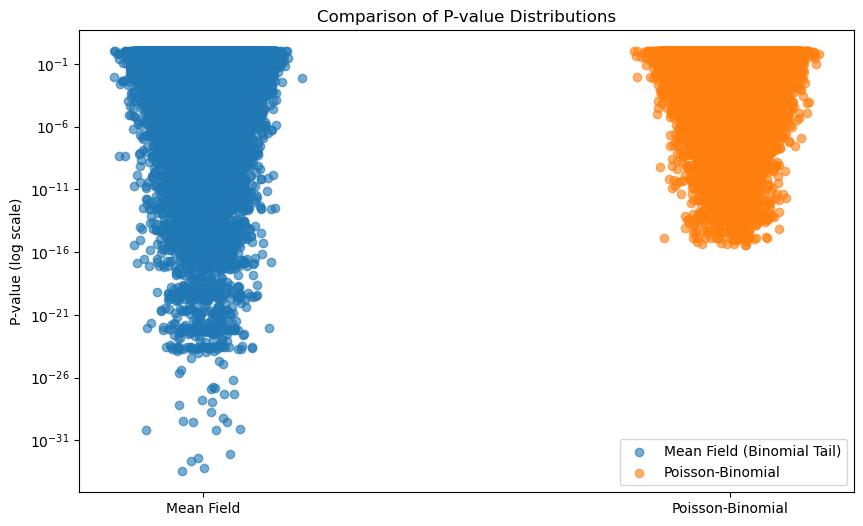

In [8]:
# plot the two p-value distributions as two jitterplots on log scale
plt.figure(figsize=(10, 6))
x1 = np.random.normal(1, 0.04, size=len(pi_mean_field))
x2 = np.random.normal(2, 0.04, size=len(pi_poibin))
plt.scatter(x1, pi_mean_field, alpha=0.6, label='Mean Field (Binomial Tail)')
plt.scatter(x2, pi_poibin, alpha=0.6, label='Poisson-Binomial')
plt.yscale('log')
plt.xticks([1, 2], ['Mean Field', 'Poisson-Binomial'])
plt.ylabel('P-value (log scale)')
plt.title('Comparison of P-value Distributions')
plt.legend()
plt.show()

Correlation between Mean Field and Poisson-Binomial p-values: 0.904204890332631


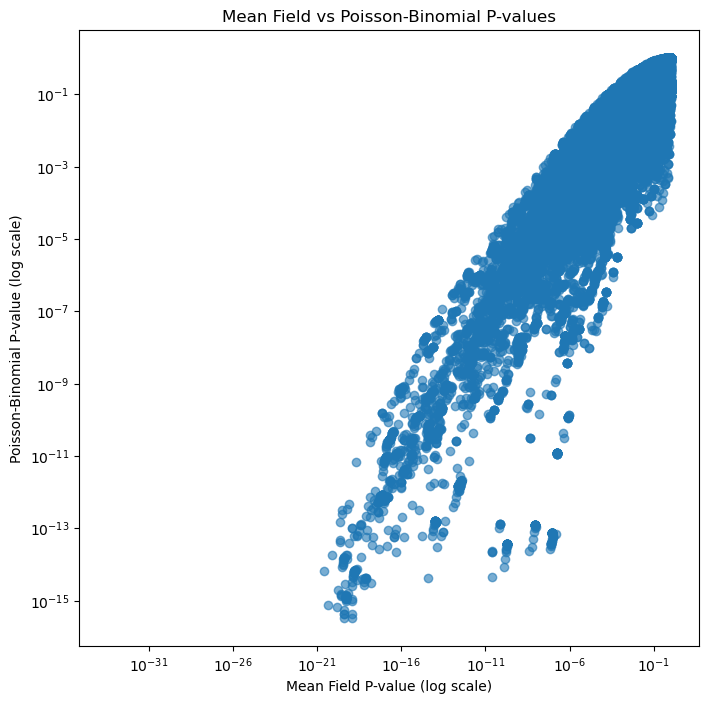

In [14]:
# check correlation between the two p-value lists
correlation = np.corrcoef(pi_mean_field, pi_poibin)[0, 1]
print(f"Correlation between Mean Field and Poisson-Binomial p-values: {correlation}")

# plot the two p-value in a scatter plot to see their relationship
plt.figure(figsize=(8, 8))
plt.scatter(pi_mean_field, pi_poibin, alpha=0.6)
plt.xscale('log')
plt.yscale('log')
plt.xlabel('Mean Field P-value (log scale)')
plt.ylabel('Poisson-Binomial P-value (log scale)')
plt.title('Mean Field vs Poisson-Binomial P-values')
plt.show()

__________

In [10]:
res_path = '../../test_opt.tsv'
pval_mf = []
pval_pb = []
count_significant_good = 0
count_significant_bad = 0
counts = 0
with open(res_path, 'r') as res_f:
	for line in res_f:
		counts += 1
		# skip header
		if line.startswith("out_chr"):
			continue
		parts = line.strip().split('\t')
		mfp = float(parts[10])
		pbp = float(parts[11])
		pval_mf.append(mfp)
		pval_pb.append(pbp)
		if mfp < 0.05 and pbp > 0.05:
			count_significant_good += 1
		if mfp > 0.05 and pbp < 0.05:
			count_significant_bad += 1
print(f"Number of cases where PB p-value < 0.05 and MF p-value > 0.05: {count_significant_bad}")
print(f"Number of cases where MF p-value < 0.05 and PB p-value > 0.05: {count_significant_good}")
print(f"Total number of cases: {counts-1}")
print(f"Proportion (good): {count_significant_good / (counts-1):.4f}")
print(f"Proportion (bad): {count_significant_bad / (counts-1):.4f}")

Number of cases where PB p-value < 0.05 and MF p-value > 0.05: 371
Number of cases where MF p-value < 0.05 and PB p-value > 0.05: 21143
Total number of cases: 169060
Proportion (good): 0.1251
Proportion (bad): 0.0022


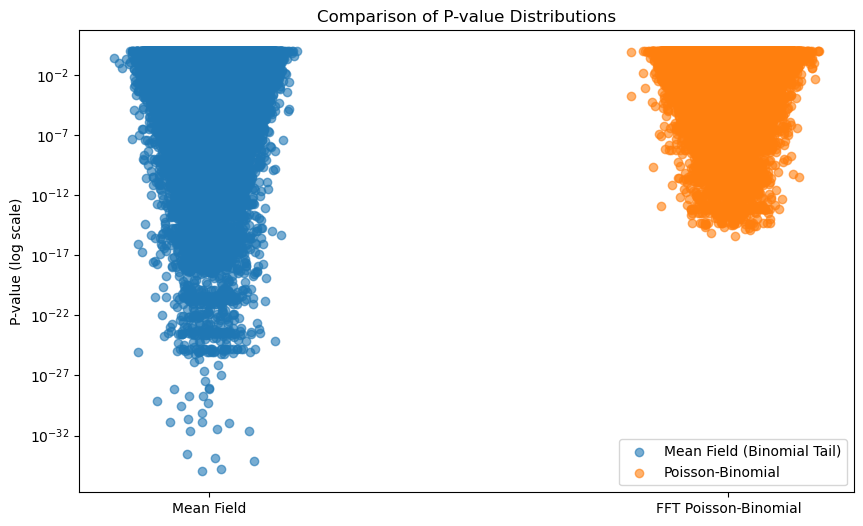

In [ ]:
plt.figure(figsize=(10, 6))
x1 = np.random.normal(1, 0.04, size=len(pval_mf))
x2 = np.random.normal(2, 0.04, size=len(pval_pb))
plt.scatter(x1, pval_mf, alpha=0.6, label='Mean Field (Binomial Tail)')
plt.scatter(x2, pval_pb, alpha=0.6, label='Poisson-Binomial')
plt.yscale('log')
plt.xticks([1, 2], ['Mean Field', 'FFT Poisson-Binomial'])
plt.ylabel('P-value (log scale)')
plt.title('Comparison of P-value Distributions')
plt.legend()
plt.show()

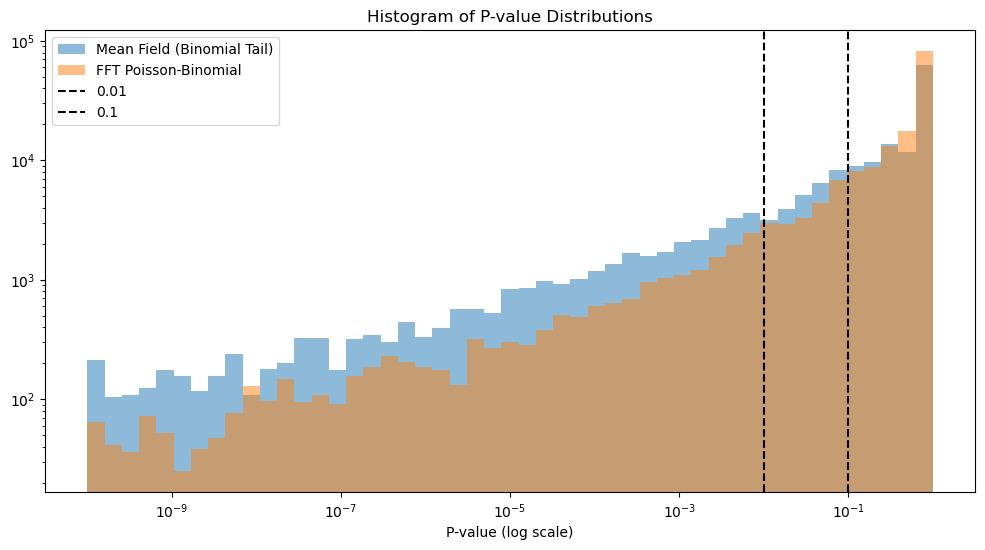

In [ ]:
# plot histograms of the two p-value distributions. Use log scale for yx axis
bins = np.logspace(-10, 0, 50)
plt.figure(figsize=(12, 6))
plt.hist(pval_mf, bins=bins, alpha=0.5, label='Mean Field (Binomial Tail)')
plt.hist(pval_pb, bins=bins, alpha=0.5, label='FFT Poisson-Binomial')
plt.axvline(x=0.01, color='black', linestyle='--', label='0.01')
plt.axvline(x=0.1, color='black', linestyle='--', label='0.1')
plt.xscale('log')
plt.yscale('log')
plt.xlabel('P-value (log scale)')
plt.title('Histogram of P-value Distributions')
plt.legend()
plt.show()

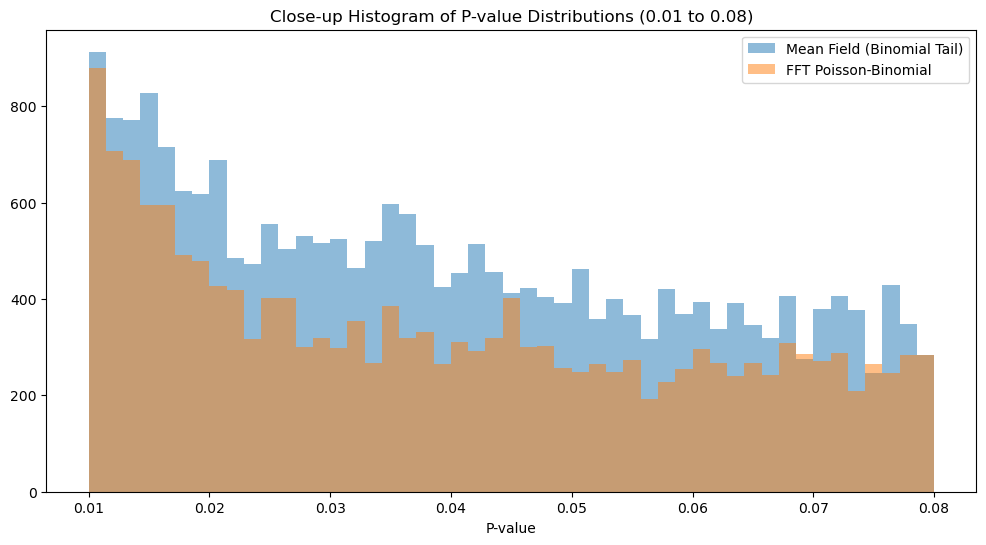

In [ ]:
# in the range 0.01 to 0.1 plot a close-up histogram
bins = np.linspace(0.01, 0.08, 50)
plt.figure(figsize=(12, 6))
plt.hist([p for p in pval_mf if 0.01 <= p <= 0.08], bins=bins, alpha=0.5, label='Mean Field (Binomial Tail)')
plt.hist([p for p in pval_pb if 0.01 <= p <= 0.08], bins=bins, alpha=0.5, label='FFT Poisson-Binomial')
plt.xlabel('P-value')
plt.title('Close-up Histogram of P-value Distributions (0.01 to 0.08)')
plt.legend()
plt.show()